In [1]:
import os
import time
import numpy as np
import pandas as pd

from skimage import io

import matplotlib.pyplot as plt

from CellSeg.segmentation import Segmentation
from CellSeg.analysis import cell_analysis, edge_analysis, face_analysis
from ZebrafishMuscle.twist_analysis import plot_cell_twist
%load_ext snakeviz

In [2]:
%pdb

Automatic pdb calling has been turned ON


In [3]:
path = "/mnt/sda1/Sophie/6-Myotome/240205_new_data/"
seg_filename = "Reslice_DUP_Process_Process_231122-MMS-CSU__wt_tg-HRAS-GFP_25hpf_cp_masks.tif"

pixel_size = dict(x_size = 0.183,
                  y_size = 0.183,
                  z_size = 0.5,)

In [4]:
image = io.imread(os.path.join(path, seg_filename))

In [5]:
# %%snakeviz
for t in range(0,image.shape[0]):
    path_img = os.path.join(path, str(t))+'/'
    try:
        os.mkdir(path_img)
    except IOError:
        pass
    
    image_t = image[t]

    seg = Segmentation(image_t, pixel_size, path_img)
    start_time = time.time()
    
    seg.perform_prerequisite(overwrite=True, save_mesh=False)
    seg.cell_segmentation()
    seg.edge_segmentation()
    seg.face_segmentation()
    cell_analysis(seg)
    edge_analysis(seg)
    face_analysis(seg)
    
    end_time = time.time()
    print(str(t) + "\t"+str(end_time-start_time))

0	5.814310073852539
1	8.10151219367981
2	7.020732164382935
3	9.670634269714355
4	14.16858458518982
5	16.247739553451538
6	16.25981569290161
7	20.136987924575806
8	19.87936282157898
9	26.881905555725098
10	42.9195511341095
11	102.94335436820984
12	211.87441515922546
13	382.3818356990814
14	435.14201068878174
15	563.5779259204865
16	581.3811750411987
17	704.2246572971344
18	769.9360287189484
19	790.7912442684174
20	802.951388835907
21	793.9620976448059
22	769.2264931201935
23	849.7268452644348
24	850.4693217277527
25	734.7610399723053
26	668.4074697494507
27	720.6940598487854
28	614.5683965682983
29	649.6785063743591
30	676.4139490127563
31	673.0588181018829
32	641.5779068470001


In [6]:
# cell twist analysis
for t in range(33):
    path_img = os.path.join(path, str(t)+'/')
        
    cell_df = pd.read_csv(os.path.join(path_img, "cell_df.csv"), index_col="Unnamed: 0")
    for c_id in cell_df["id_im"]:
        plot_cell_twist(path_img, c_id, cell_df, pixel_size)

/tmp/ipykernel_245516/3399353548.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


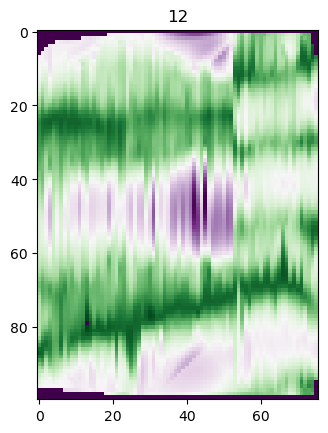

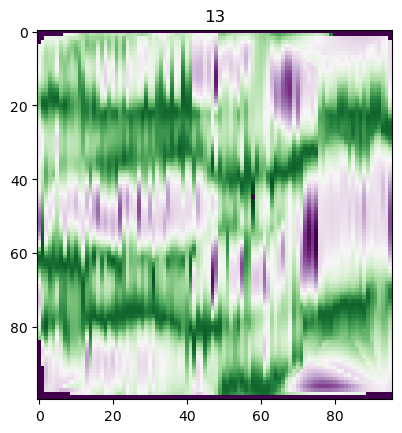

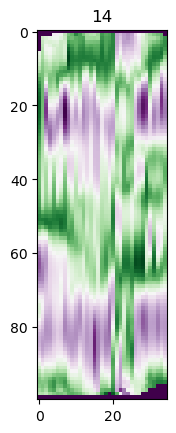

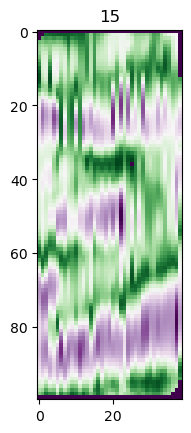

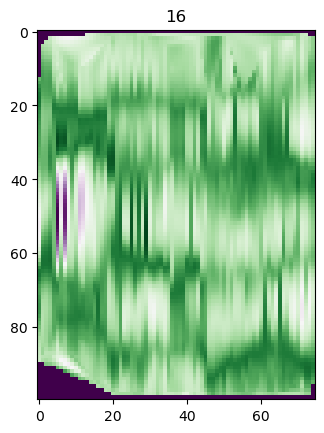

...

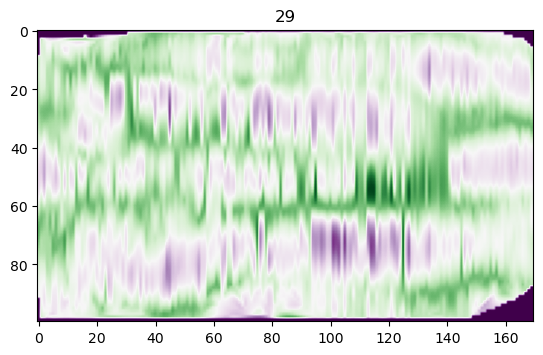

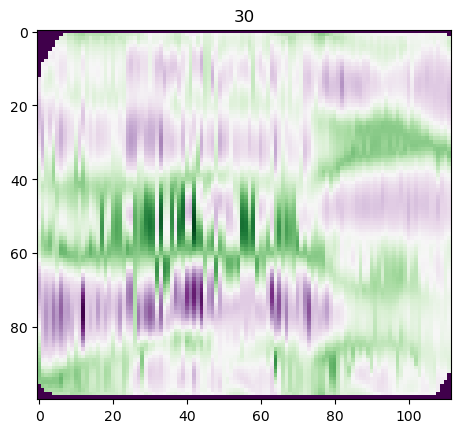

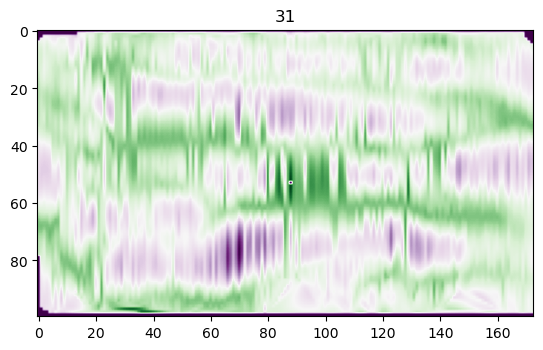

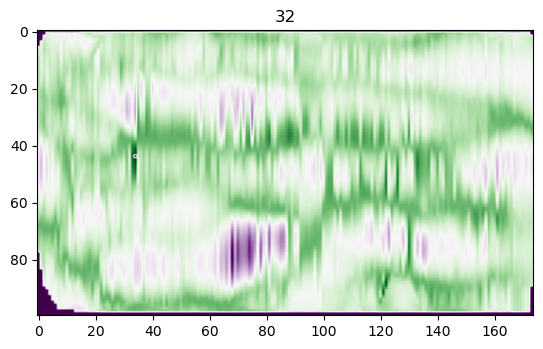

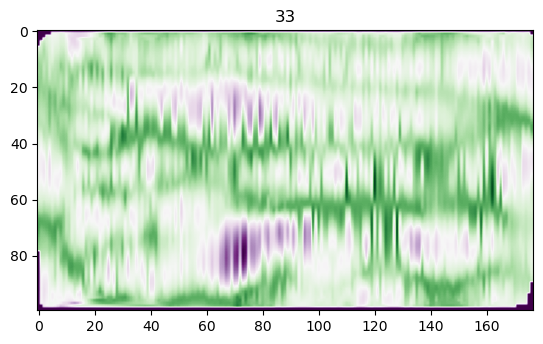

In [154]:
c_id = 123
for t in range(33):
    
    path_img = os.path.join(path, str(t)+'/twist/')
    if os.path.exists(os.path.join(path_img, str(c_id)+".tif")):
        fig, ax = plt.subplots()
        image = io.imread(os.path.join(path_img, str(c_id)+".tif"))
        plt.title(t+1)
        ax.imshow(image, cmap="PRGn", )

Text(0.5, 0, 'x')

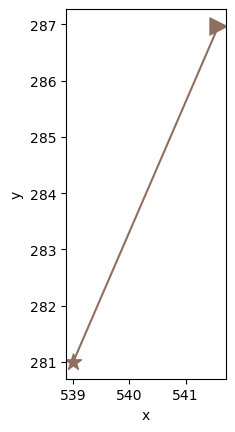

In [60]:
fig, ax = plt.subplots()

ax.scatter(cell_df[cell_df['y_center']>limit]['y_start'], 
           cell_df[cell_df['y_center']>limit]['x_start'],
           color = np.array(color_list)[cell_df[cell_df['y_center']>limit]['id_im']],
#            c = cell_df[cell_df['y_center']>limit]['id_im'],
#            cmap=mcolors.LinearSegmentedColormap.from_list('mymap', color_list),
           s=150,
           marker='>',
          )
ax.scatter(cell_df[cell_df['y_center']>limit]['y_end'],
           cell_df[cell_df['y_center']>limit]['x_end'],
           color = np.array(color_list)[cell_df[cell_df['y_center']>limit]['id_im']],
#            c = cell_df[cell_df['y_center']>limit]['id_im'],
#            cmap=mcolors.LinearSegmentedColormap.from_list('mymap', color_list),
           s=150, 
           marker = '*')

for i, val in cell_df[cell_df['y_center']>limit].iterrows():
    ax.plot([val["y_end"], val['y_start']],
            [val["x_end"], val['x_start']],
            '-',
            markersize=15,
           color = np.array(color_list)[int(val['id_im'])],)
#            cmap=mcolors.LinearSegmentedColormap.from_list('mymap', color_list),)

ax.set_aspect('equal', 'box')
# ax.set_xlim(0,900)
# ax.set_ylim(0,350)
ax.set_ylabel('y')
ax.set_xlabel('x')

# Flow field analysis

In [5]:
import ZebrafishMuscle.flow_analysis as ZMflow
import ZebrafishMuscle.plot as ZMplot
import random 
import matplotlib.colors as mcolors

/tmp/ipykernel_245516/798707268.py:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(tight_layout=True)


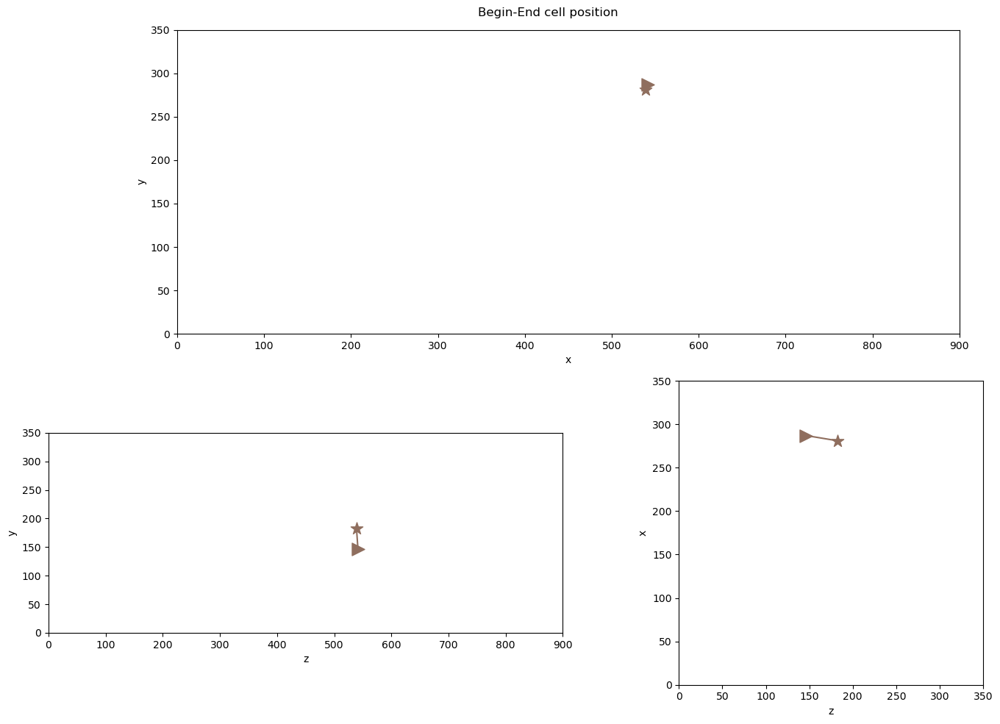

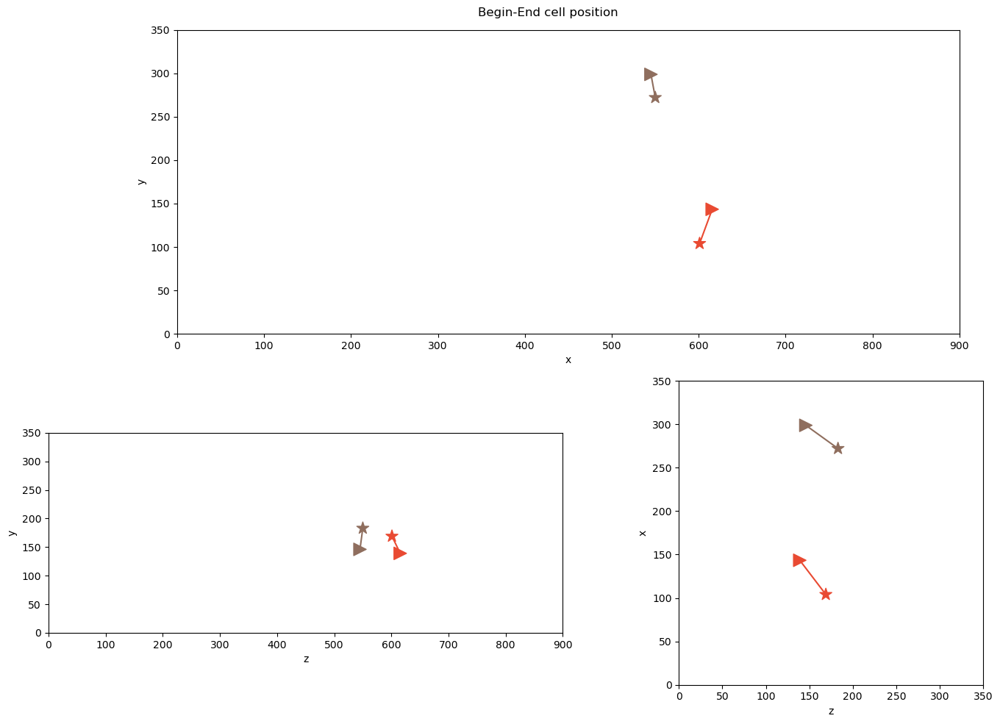

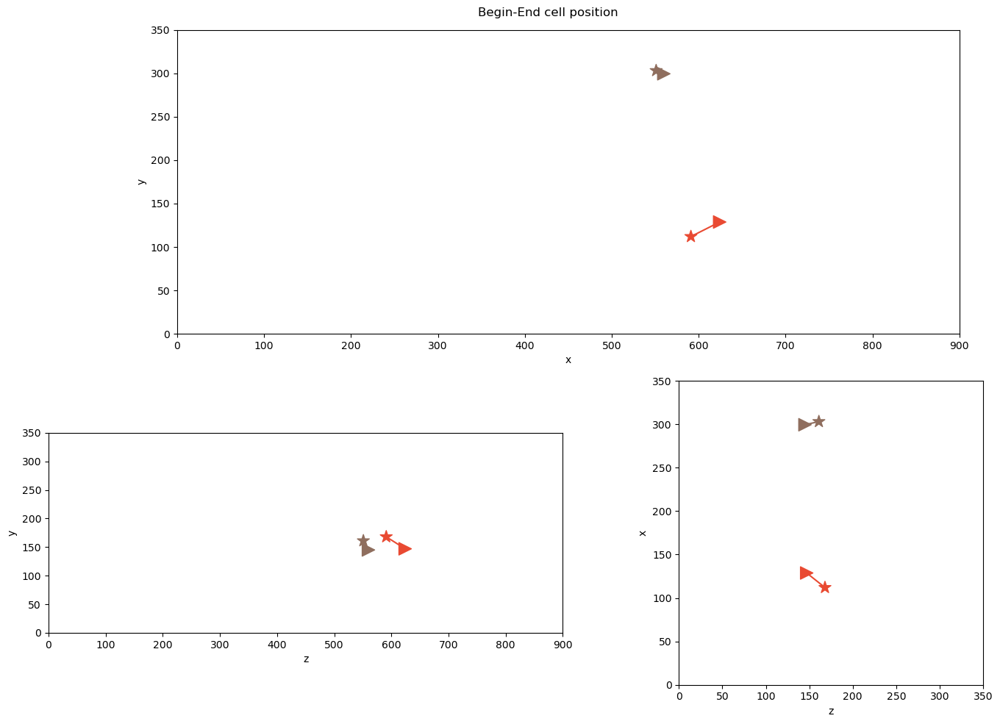

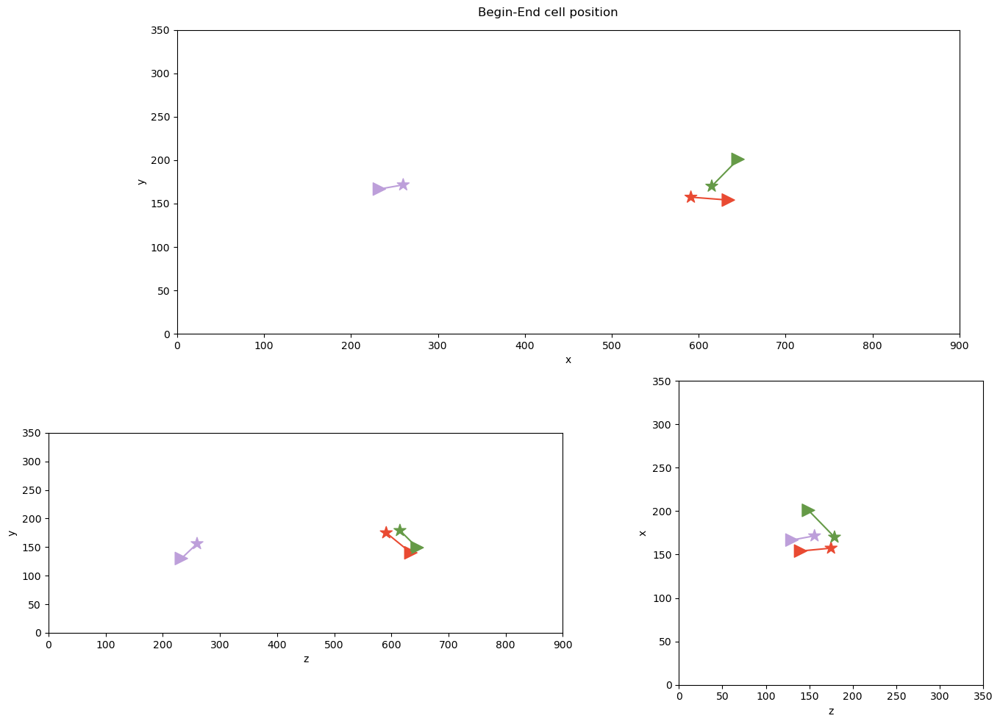

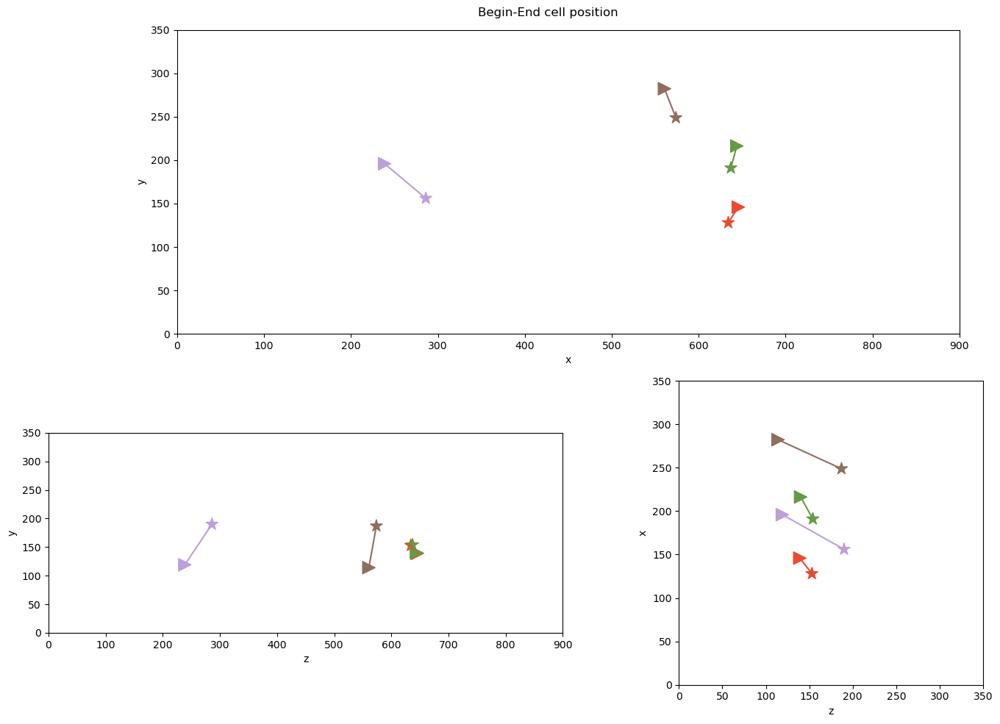

...

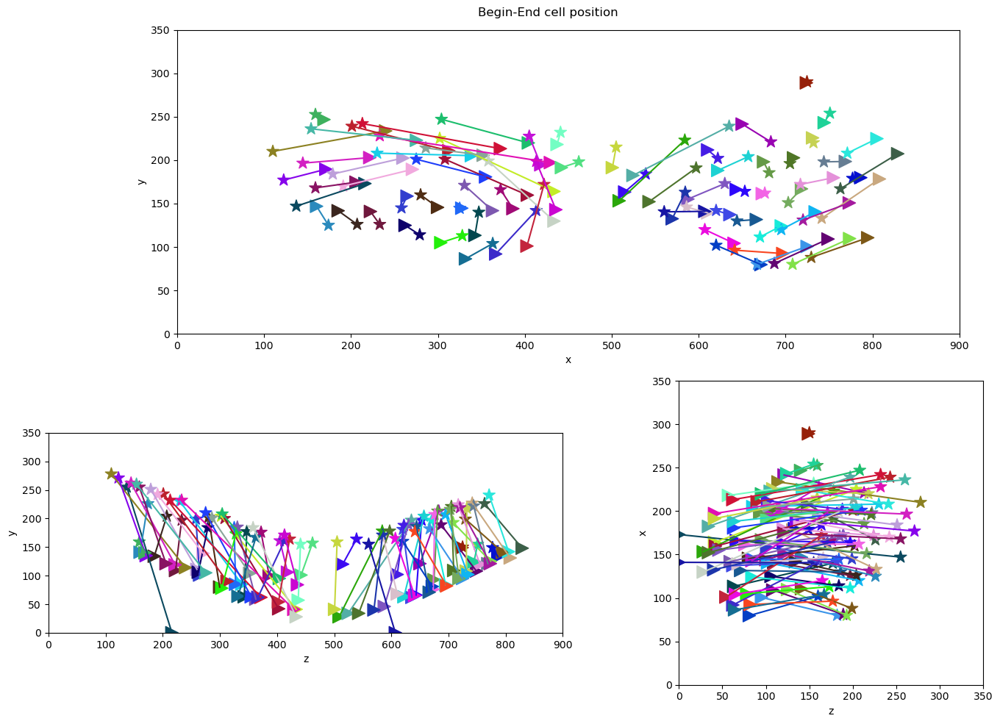

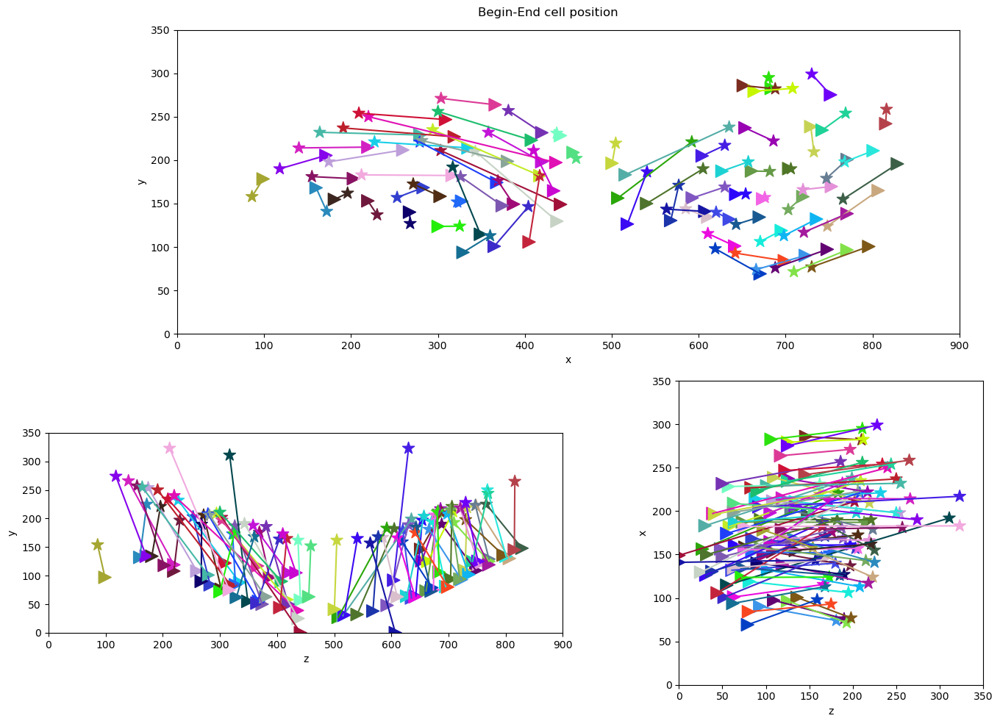

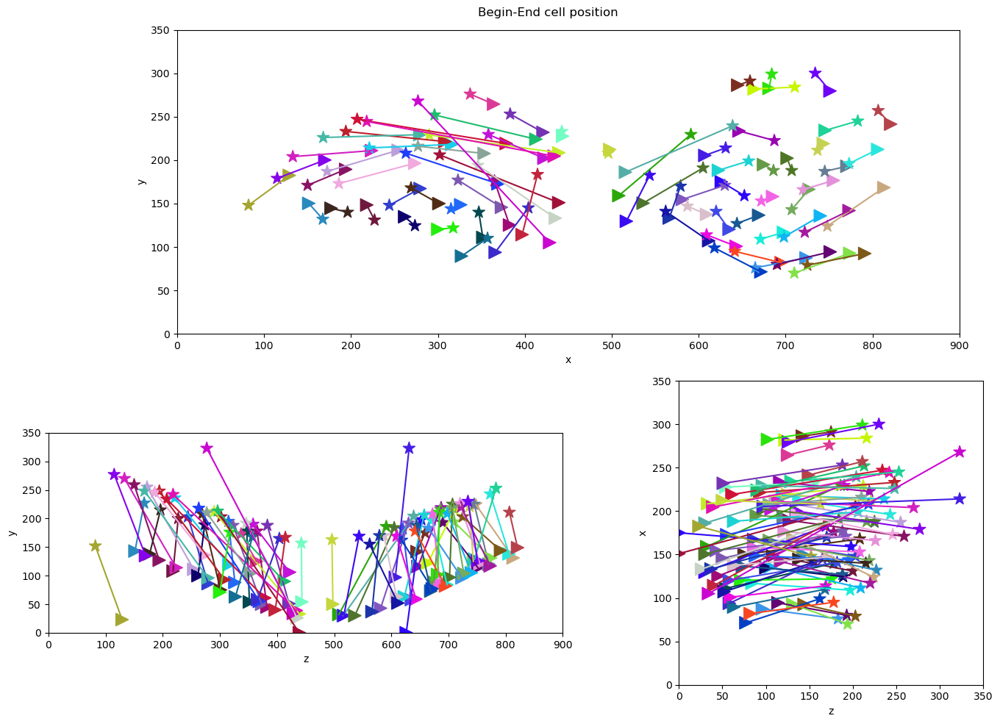

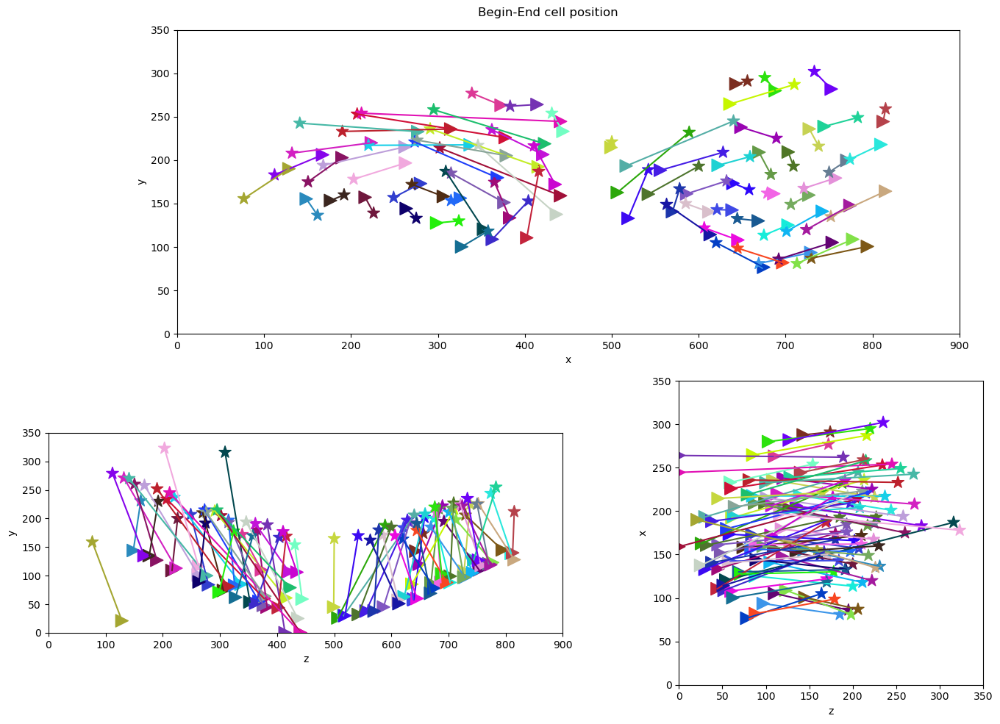

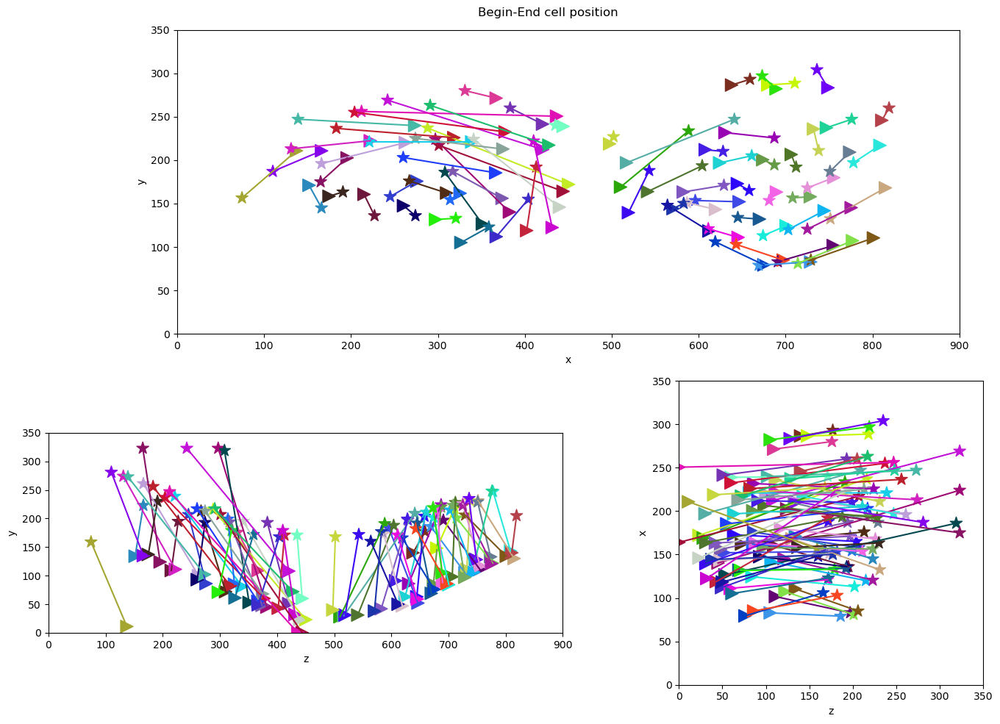

In [61]:
# limit = 0
# get_colors = lambda n: ["#%06x" % random.randint(0, 0xFFFFFF) for _ in range(n)]
# color_list = get_colors(300)
    
for t in range(image.shape[0]):


    path_img = os.path.join(path, str(t)+'/')

    cell_df = pd.read_csv(os.path.join(path_img, "cell_df.csv"), index_col="Unnamed: 0")
    cell_plane_df = pd.read_csv(os.path.join(path_img, "cell_plane_df.csv"), index_col="Unnamed: 0")
    edge_df = pd.read_csv(os.path.join(path_img, "edge_df.csv"), index_col="Unnamed: 0")
    edge_pixel_df = pd.read_csv(os.path.join(path_img, "edge_pixel_df.csv"), index_col="Unnamed: 0")
    ZMflow.cell_movement_inside_chevron(cell_plane_df, cell_df, edge_pixel_df, limit=0)
    
    

    # draw plot

    import matplotlib.gridspec as gridspec
    fig = plt.figure(tight_layout=True)
    gs = gridspec.GridSpec(2, 2)


    # TOP plot
    ax = fig.add_subplot(gs[0, :])

    ax.scatter(cell_df[cell_df['y_center']>limit]['y_start'], 
               cell_df[cell_df['y_center']>limit]['x_start'],
               color = np.array(color_list)[cell_df[cell_df['y_center']>limit]['id_im']],
               s=150,
               marker='>',
              )
    ax.scatter(cell_df[cell_df['y_center']>limit]['y_end'],
               cell_df[cell_df['y_center']>limit]['x_end'],
               color = np.array(color_list)[cell_df[cell_df['y_center']>limit]['id_im']],
               s=150, 
               marker = '*')

    for i, val in cell_df[cell_df['y_center']>limit].iterrows():
        ax.plot([val["y_end"], val['y_start']],
                [val["x_end"], val['x_start']],
               color = np.array(color_list)[int(val['id_im'])],)

    ax.set_aspect('equal', 'box')
    ax.set_xlim(0,900)
    ax.set_ylim(0,350)
    ax.set_ylabel('y')
    ax.set_xlabel('x')

    # BOTTOM LEFT
    ax = fig.add_subplot(gs[1, 0])

    ax.scatter(cell_df[cell_df['y_center']>limit]['y_start'], 
               cell_df[cell_df['y_center']>limit]['z_start'],
               color = np.array(color_list)[cell_df[cell_df['y_center']>limit]['id_im']],
               s=150,
               marker='>',
              )
    ax.scatter(cell_df[cell_df['y_center']>limit]['y_end'],
               cell_df[cell_df['y_center']>limit]['z_end'],
               color = np.array(color_list)[cell_df[cell_df['y_center']>limit]['id_im']],
               s=150, 
               marker = '*')


    for i, val in cell_df[cell_df['y_center']>limit].iterrows():
        ax.plot([val["y_end"], val['y_start']],
                [val["z_end"], val['z_start']],
               color = np.array(color_list)[int(val['id_im'])],
               )

    ax.set_aspect('equal', 'box')
    ax.set_ylabel('y')
    ax.set_xlabel('z')
    ax.set_xlim(0,900)
    ax.set_ylim(0,350)


    # BOTTOM right
    ax = fig.add_subplot(gs[1, 1])

    ax.scatter(cell_df[cell_df['y_center']>limit]['z_start'], 
               cell_df[cell_df['y_center']>limit]['x_start'],
               color = np.array(color_list)[cell_df[cell_df['y_center']>limit]['id_im']],
               s=150,
               marker='>',
              )
    ax.scatter(cell_df[cell_df['y_center']>limit]['z_end'],
               cell_df[cell_df['y_center']>limit]['x_end'],
               color = np.array(color_list)[cell_df[cell_df['y_center']>limit]['id_im']],
               s=150, 
               marker = '*')

    
    for i, val in cell_df[cell_df['y_center']>limit].iterrows():
        ax.plot([val["z_end"], val['z_start']],
                [val["x_end"], val['x_start']],
               color = np.array(color_list)[int(val['id_im'])],)
        

    ax.set_aspect('equal', 'box')
    ax.set_ylabel('x')
    ax.set_xlabel('z')
    ax.set_xlim(0,350)
    ax.set_ylim(0,350)

    #fig.align_labels()  # same as fig.align_xlabels(); fig.align_ylabels()
    fig.set_size_inches(15,10)
    fig.suptitle("Begin-End cell position")
#     plt.show()
    fig.savefig("profil/profil_"+str(t)+'.png')

/home/u2175049/anaconda3/lib/python3.11/site-packages/matplotlib/quiver.py:627: RuntimeWarning: Mean of empty slice.
  amean = a[~self.Umask].mean()
/home/u2175049/anaconda3/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/u2175049/anaconda3/lib/python3.11/site-packages/matplotlib/quiver.py:627: RuntimeWarning: Mean of empty slice.
  amean = a[~self.Umask].mean()
/home/u2175049/anaconda3/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/u2175049/anaconda3/lib/python3.11/site-packages/matplotlib/quiver.py:627: RuntimeWarning: Mean of empty slice.
  amean = a[~self.Umask].mean()
/home/u2175049/anaconda3/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/u2175049/anac

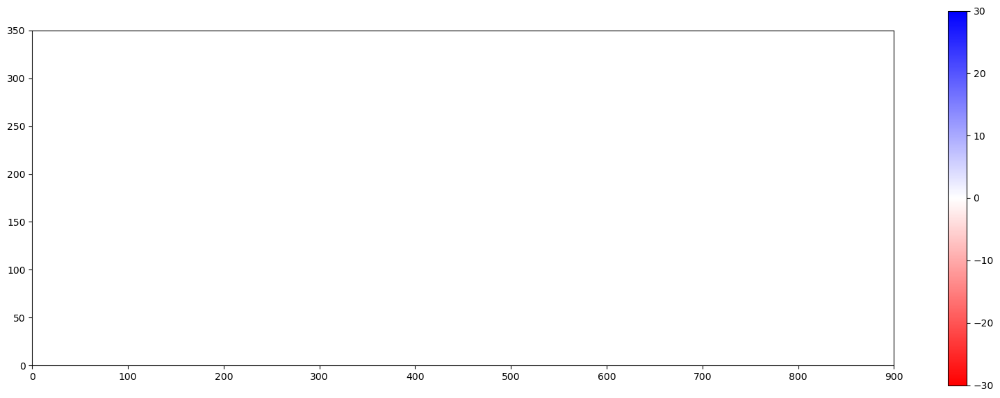

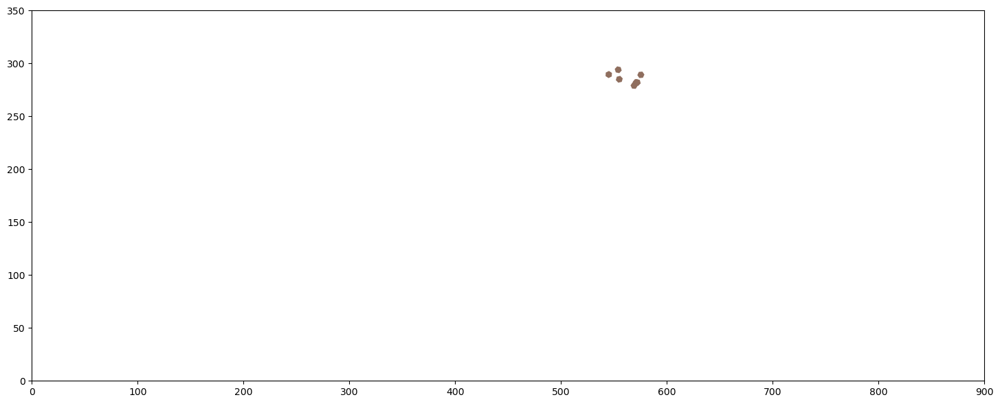

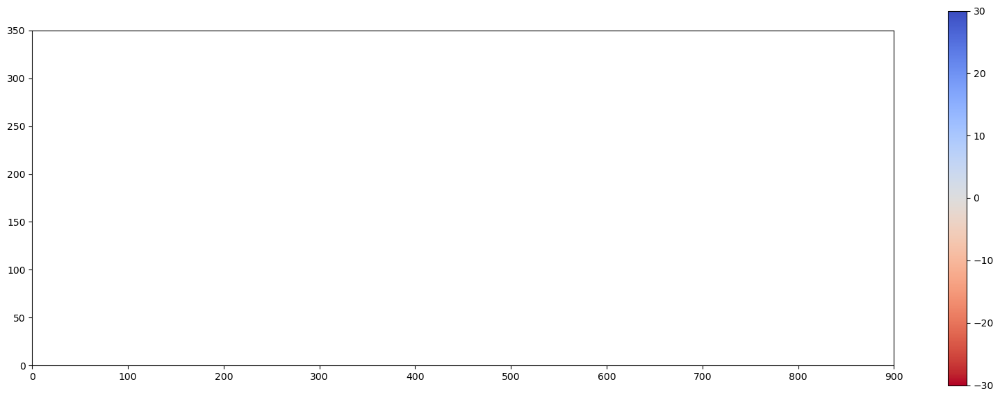

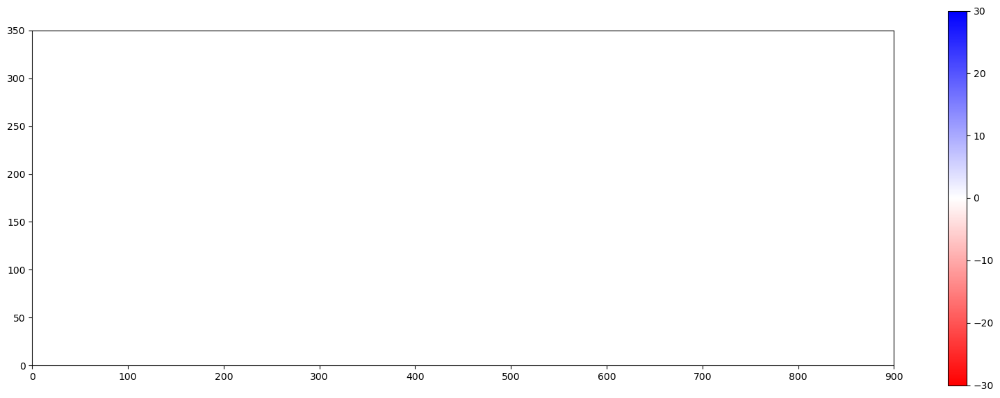

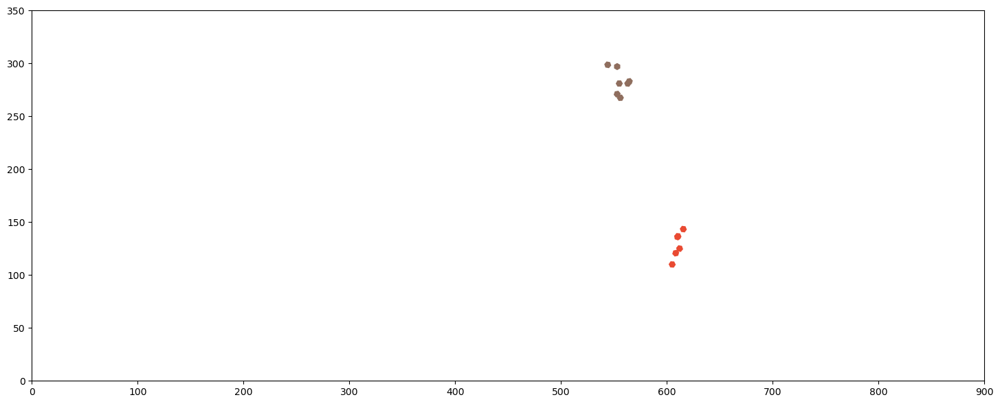

...

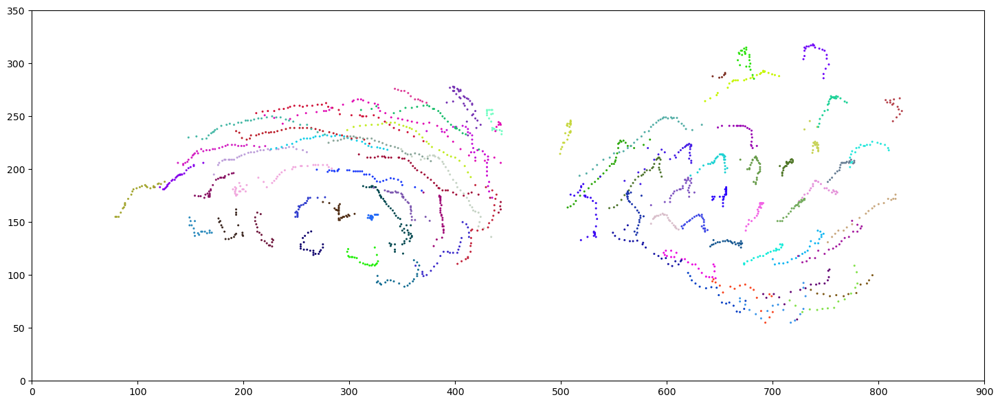

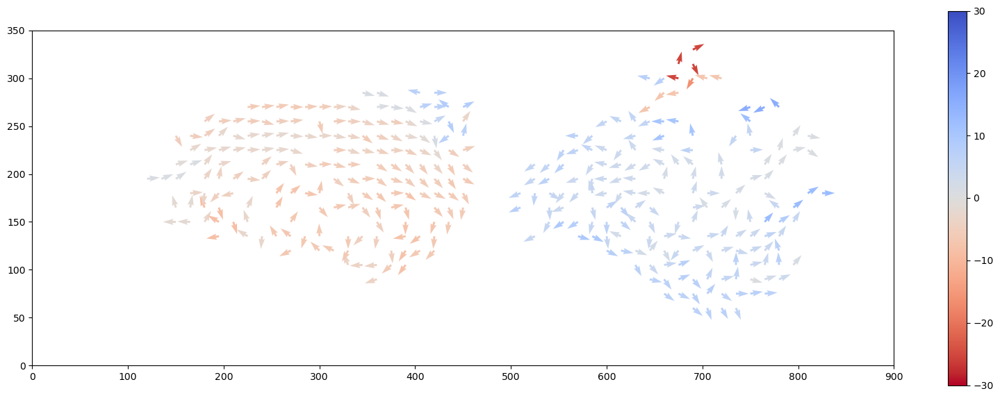

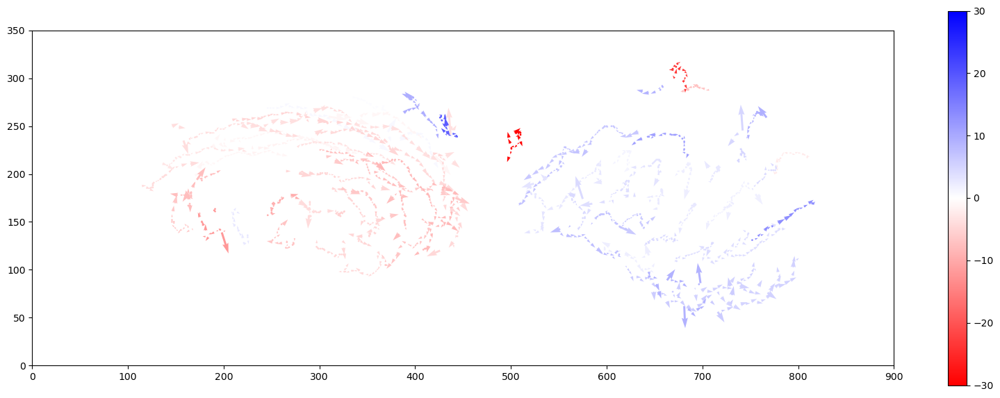

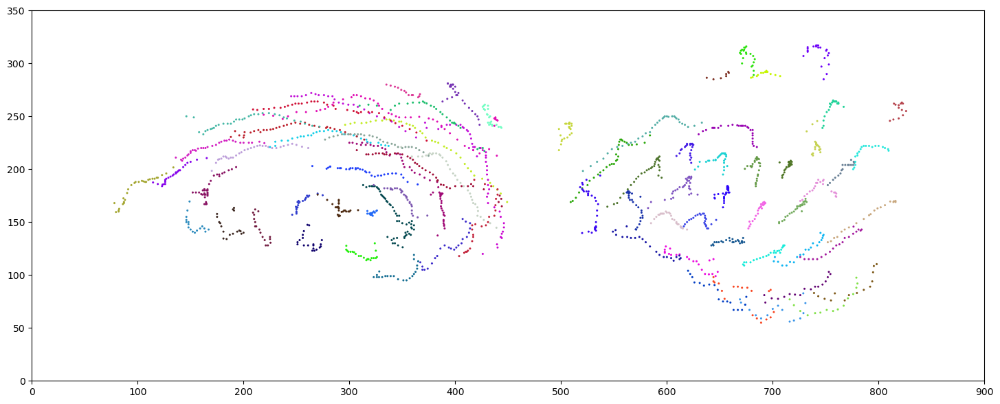

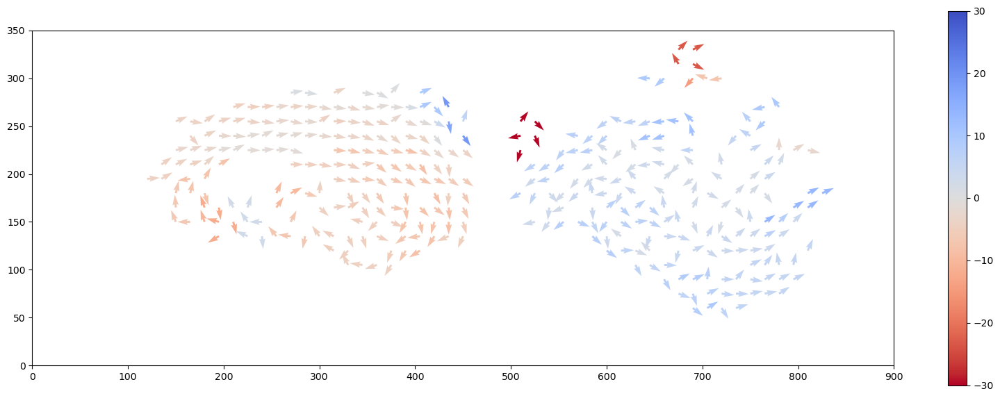

In [94]:
for t in range(image.shape[0]):


    path_img = os.path.join(path, str(t)+'/')

    cell_df = pd.read_csv(os.path.join(path_img, "cell_df.csv"), index_col="Unnamed: 0")
    cell_plane_df = pd.read_csv(os.path.join(path_img, "cell_plane_df.csv"), index_col="Unnamed: 0")
    edge_df = pd.read_csv(os.path.join(path_img, "edge_df.csv"), index_col="Unnamed: 0")
    edge_pixel_df = pd.read_csv(os.path.join(path_img, "edge_pixel_df.csv"), index_col="Unnamed: 0")
    
    ZMflow.cell_movement_inside_chevron(cell_plane_df, cell_df, edge_pixel_df, limit=0)
    
    vector_datas = ZMflow.pos_to_vector(cell_plane_df, 
                                      cell_df, 
                                      step=5, 
                                      ascending=False, 
                                      pixel_size=0.183)        

    fig, ax = plt.subplots()
    cs = ax.quiver(
        vector_datas["y"].to_numpy(), 
        vector_datas["x"].to_numpy(),
        vector_datas["vy"].to_numpy(), 
        vector_datas["vx"].to_numpy(), 
        -vector_datas['twist']*180/np.pi,
        cmap = 'bwr_r',
        scale=1,
        scale_units='x',
        angles="xy",
        alpha=1,
        clim=(-30,30),
        )
    ax.set_aspect('equal', 'box')
    cbar = fig.colorbar(cs,)

    fig.set_size_inches((20,7))
    ax.set_xlim(0,900)
    ax.set_ylim(0,350)
    fig.savefig("flowfield/flowfield_"+str(t)+'.png')
    
    
    #-----    
    fig, ax = plt.subplots()
    cs = ax.quiver(
        vector_datas["y"].to_numpy(), 
        vector_datas["x"].to_numpy(),
        vector_datas["vy"].to_numpy()/np.sqrt(vector_datas['vx']**2+vector_datas['vy']**2), 
        vector_datas["vx"].to_numpy()/np.sqrt(vector_datas['vx']**2+vector_datas['vy']**2), 
        color=np.array(color_list)[(vector_datas['cell'].astype(int))],
#         vector_datas['cell'],
#         cmap = mcolors.LinearSegmentedColormap.from_list('mymap', color_list),
        scale=1,
        scale_units='x',
        angles="xy",
        alpha=1,
        clim=(0,300),
        )
    ax.set_aspect('equal', 'box')
#     cbar = fig.colorbar(cs,)

    fig.set_size_inches((20,7))
    ax.set_xlim(0,900)
    ax.set_ylim(0,350)
    fig.savefig("flowfield_cellcolor/flowfield_cellcolor_"+str(t)+'.png')
    
    
    #--------
    mean_vector_datas = ZMflow.mean_displacement(vector_datas, 
                                                   x_size=image.shape[1],
                                                   y_size=image.shape[2],
                                                   step=15)
    mean_vector_datas['new_angle'] = abs(np.arctan2(mean_vector_datas.vy, mean_vector_datas.vx))
    PIXEL_SIZE=0.183
    import matplotlib
    fig, ax = plt.subplots()
    cs = ax.quiver(
        mean_vector_datas["y"].to_numpy(),
        mean_vector_datas["x"].to_numpy(), 
        mean_vector_datas["vy"].to_numpy()/np.sqrt(mean_vector_datas['vx']**2+mean_vector_datas['vy']**2), 
        mean_vector_datas["vx"].to_numpy()/np.sqrt(mean_vector_datas['vx']**2+mean_vector_datas['vy']**2), 
    #     quiver_data2['angle']*180/np.pi,
        -mean_vector_datas['twist']*180/np.pi,
#         cmap = 'bwr_r',
        cmap = 'coolwarm_r',
    #     scale=10000,
        scale_units='x',
        angles="xy",
        clim=(-30,30),
        )

    ax.set_aspect('equal', 'box')
    cbar = fig.colorbar(cs,)
    fig.set_size_inches((20,7))
    ax.set_xlim(0,900)
    ax.set_ylim(0,350)
    fig.savefig("flowfield2/flowfield_"+str(t)+'.png')

In [6]:
def pos_to_vector_tip(path, time_range, tip="start", ascending=False, pixel_size=0.183):
    """ Transform position along z axis into vector datas
    Parameters
    ----------
    cell_plane_df (pd.DataFrame): dataframe
    cell_df (pd.DataFrame): dataframe
    step (int): default 5. 1 if you want to take into account every slice
    ascending (bool): default False.Consider z-planes in ascending or descending direction
    pixel_size (float): pixel size value to calculate speed

    Returns
    -------
    vector_datas (pd.DataFrame)
    """
    
    
    vector_datas = pd.DataFrame(columns=["cell",
                                         "time",
                                         "x",
                                         "y",
                                         "z",
                                         "vx",
                                         "vy",
                                         "dist",
                                         "speed",
                                         ])
    
    if tip=="start":
        pos = 0
    elif tip=="end":
        pos=-1
    
    for t in range(time_range):
        path_img = os.path.join(path, str(t)+'/')
        cell_plane_df = pd.read_csv(os.path.join(path_img, "cell_plane_df.csv"), index_col="Unnamed: 0")
        
        
        for cell in np.unique(cell_plane_df["id_im"]):
            tmp = pd.DataFrame({"cell": cell,
                              "time":t,
                              "x": cell_plane_df[cell_plane_df['id_im'] == cell].iloc[pos][["x_center"]].to_numpy()[0],
                              "y": cell_plane_df[cell_plane_df['id_im'] == cell].iloc[pos][["y_center"]].to_numpy()[0],
                              "z": cell_plane_df[cell_plane_df['id_im'] == cell].iloc[pos][["z_center"]].to_numpy()[0],
                             },
                               index=[0])
            vector_datas = pd.concat([df for df in [vector_datas, tmp] if not df.empty],
                                  ignore_index=True)
    
    vector_datas["vx"]=0
    vector_datas["vy"]=0
    vector_datas["vz"]=0
    
    for name, group in vector_datas.groupby("cell"):
        vector_datas.loc[group.diff().index,["vx", "vy", "vz"]] = group.diff()[list("xyz")].to_numpy()
    
    vector_datas["dist"] = np.sqrt(vector_datas['vx']**2 + vector_datas['vy']**2+vector_datas['vz']**2)
    vector_datas["speed"] = vector_datas["dist"]/1
    return vector_datas
        
def mean_displacement_tip(vector_datas, x_size=10, y_size=10, step=1):
    """

    Parameters
    ----------
    vector_datas (pd.DataFrame):
    x_size (float): default 10. Size of the grid in x-axis
    y_size (float): default 10. Size of the grid in y-axis
    step (int) : default 1. Density of the grid

    Returns
    -------
    mean_vector_datas (pd.DataFrame)
    """
    xv, yv = np.meshgrid(np.arange(x_size, step=step),
                         np.arange(y_size, step=step),
                         indexing='xy')

    mean_vector_datas = pd.DataFrame(columns=vector_datas.columns)

    for i, j in zip(xv.ravel(), yv.ravel()):
        means_ = vector_datas[(vector_datas['x'] >= i) & (vector_datas['x'] < i + step) &
                              (vector_datas['y'] >= j) & (vector_datas['y'] < j + step)].mean()

        count = vector_datas[(vector_datas['x'] >= i) & (vector_datas['x'] < i + step) &
                             (vector_datas['y'] >= j) & (vector_datas['y'] < j + step)].shape[0]

        tmp = pd.DataFrame.from_dict({"x": i + step,
                                      "y": j + step,
                                      "vx": means_.vx,
                                      "vy": means_.vy,
                                      "dist": means_.dist,
                                      "speed": means_.speed,
                                      "length": means_.dist,
                                      "count": count, },
                                     orient='index')
        # mean_vector_datas = pd.concat([mean_vector_datas, tmp.T], ignore_index=True)
        mean_vector_datas = pd.concat([df for df in [mean_vector_datas, tmp.T] if not df.empty],
                                  ignore_index=True)

    # Force column type as numeric
    for c in mean_vector_datas.columns:
        mean_vector_datas[c] = pd.to_numeric(mean_vector_datas[c])

    return mean_vector_datas


/tmp/ipykernel_492848/2317388097.py:54: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[         nan -14.63696366  25.27067944  -8.15477441  -9.87602379
  18.17550915 -36.02312231  35.68435219 -59.18654246   0.88216146
   3.27747142]' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  vector_datas.loc[group.diff().index,["vx", "vy", "vz"]] = group.diff()[list("xyz")].to_numpy()
/tmp/ipykernel_492848/2317388097.py:54: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[         nan   8.61791862   9.96937245  11.4444571   -8.82990052
   8.89535096 -24.570369    12.35199919 -12.25853375  19.82973035
   5.65277312]' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  vector_datas.loc[group.diff().index,["vx", "vy", "vz"]] = group.diff()[list("xyz")].to_numpy()
/tmp/ipykernel_49284

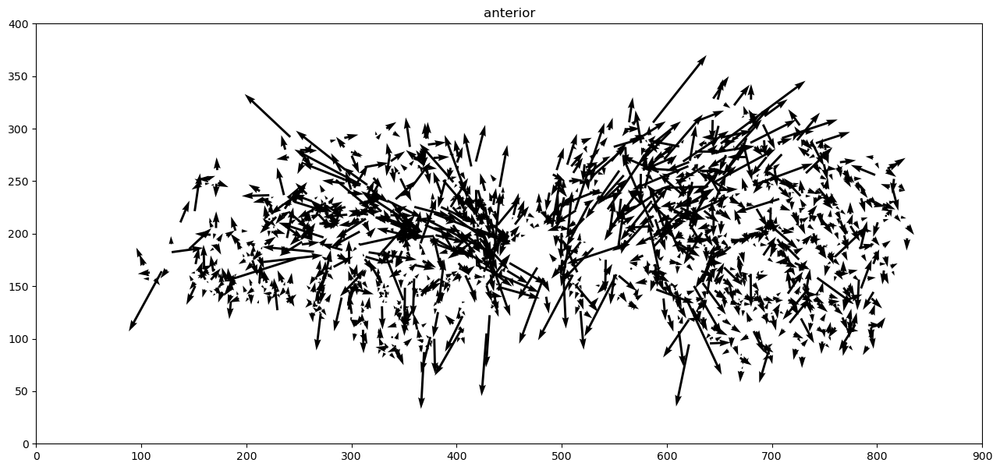

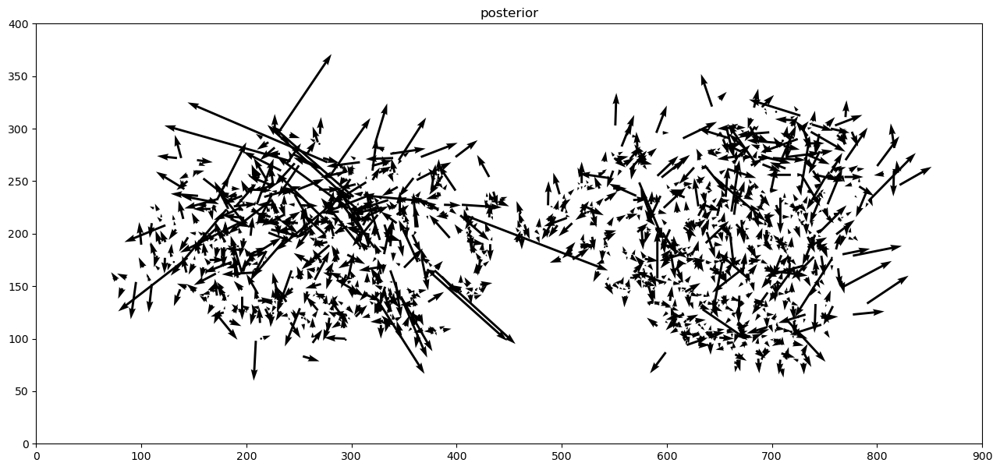

In [7]:
title = ["anterior", "posterior"]
i=0
for tip in ['start', "end"]:
    vector_datas = pos_to_vector_tip(path, 33, tip=tip)
    
    fig, ax = plt.subplots()
    cs = ax.quiver(
        vector_datas["y"].to_numpy(), 
        vector_datas["x"].to_numpy(),
        vector_datas["vy"].to_numpy(), 
        vector_datas["vx"].to_numpy(), 
        scale=1,
        scale_units='x',
        angles="xy",
        alpha=1,
        )
    ax.set_aspect('equal', 'box')
    plt.title(title[i])
    i+=1
    fig.set_size_inches((20,7))
    ax.set_xlim(0,900)
    ax.set_ylim(0,400)


/tmp/ipykernel_245516/2317388097.py:54: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[         nan -14.63696366  25.27067944  -8.15477441  -9.87602379
  18.17550915 -36.02312231  35.68435219 -59.18654246   0.88216146
   3.27747142]' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  vector_datas.loc[group.diff().index,["vx", "vy", "vz"]] = group.diff()[list("xyz")].to_numpy()
/tmp/ipykernel_245516/2317388097.py:54: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[         nan   8.61791862   9.96937245  11.4444571   -8.82990052
   8.89535096 -24.570369    12.35199919 -12.25853375  19.82973035
   5.65277312]' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  vector_datas.loc[group.diff().index,["vx", "vy", "vz"]] = group.diff()[list("xyz")].to_numpy()
/tmp/ipykernel_24551

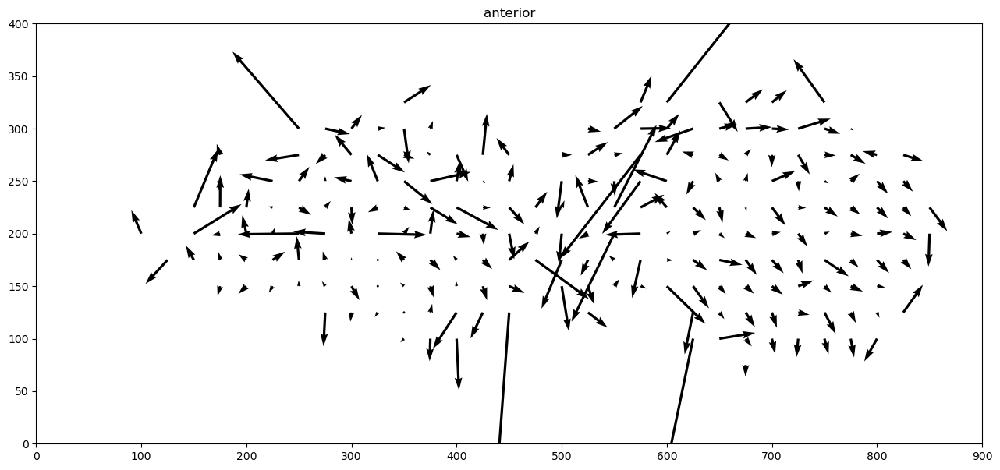

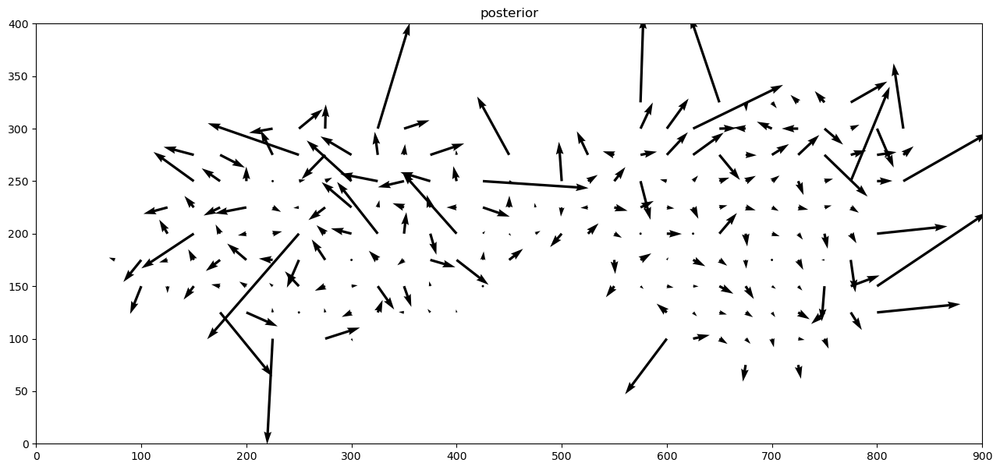

In [483]:
title = ["anterior", "posterior"]
i=0
for tip in ['start', "end"]:
    vector_datas = pos_to_vector_tip(path, 33, tip=tip)
    
    mean_vector_datas = mean_displacement_tip(vector_datas, 
                                               x_size=image.shape[1],
                                               y_size=image.shape[2],
                                               step=25)
    mean_vector_datas['new_angle'] = abs(np.arctan2(mean_vector_datas.vy, mean_vector_datas.vx))
    PIXEL_SIZE=0.183
    import matplotlib
    fig, ax = plt.subplots()
    cs = ax.quiver(
        mean_vector_datas["y"].to_numpy(),
        mean_vector_datas["x"].to_numpy(), 
        mean_vector_datas["vy"].to_numpy(),#/np.sqrt(mean_vector_datas['vx']**2+mean_vector_datas['vy']**2), 
        mean_vector_datas["vx"].to_numpy(),#/np.sqrt(mean_vector_datas['vx']**2+mean_vector_datas['vy']**2), 
    #     scale=10000,
        scale_units='x',
        angles="xy",

        )

    ax.set_aspect('equal', 'box')
    plt.title(title[i])
    i+=1
    fig.set_size_inches((20,7))
    ax.set_xlim(0,900)
    ax.set_ylim(0,400)

/tmp/ipykernel_245516/2317388097.py:54: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[         nan -14.63696366  25.27067944  -8.15477441  -9.87602379
  18.17550915 -36.02312231  35.68435219 -59.18654246   0.88216146
   3.27747142]' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  vector_datas.loc[group.diff().index,["vx", "vy", "vz"]] = group.diff()[list("xyz")].to_numpy()
/tmp/ipykernel_245516/2317388097.py:54: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[         nan   8.61791862   9.96937245  11.4444571   -8.82990052
   8.89535096 -24.570369    12.35199919 -12.25853375  19.82973035
   5.65277312]' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  vector_datas.loc[group.diff().index,["vx", "vy", "vz"]] = group.diff()[list("xyz")].to_numpy()
/tmp/ipykernel_24551

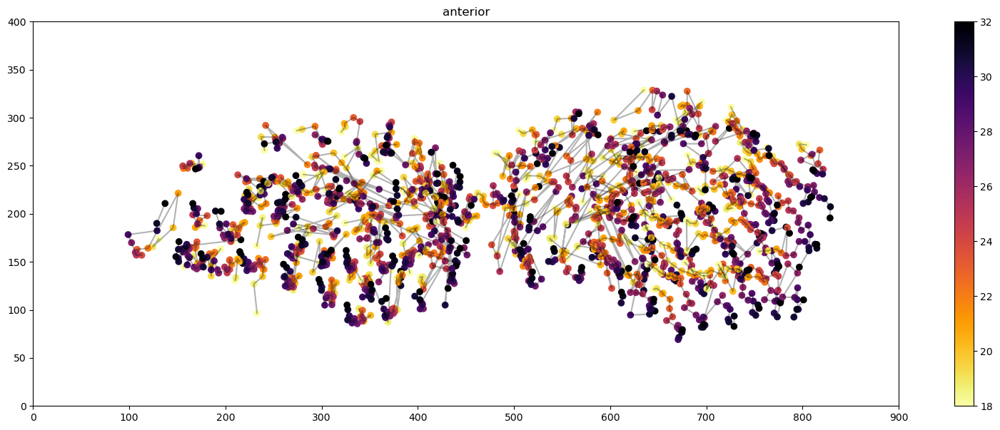

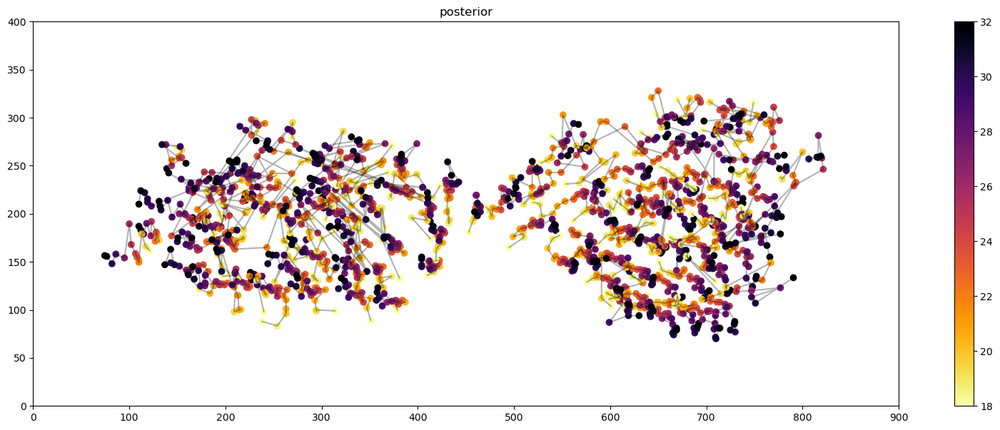

In [484]:
title = ["anterior", "posterior"]
i=0
for tip in ['start', "end"]:
    vector_datas = pos_to_vector_tip(path, 33, tip=tip)
    fig, ax = plt.subplots()
    for name, group in vector_datas.groupby("cell"):
        cs = ax.scatter(group["y"], group["x"], c=group["time"], cmap="inferno_r")
        ax.plot(group["y"], group["x"], color="black", alpha=0.3)
        
    cbar = fig.colorbar(cs,)
    ax.set_aspect('equal', 'box')
    fig.set_size_inches((20,7))
    plt.title(title[i])
    i+=1
    ax.set_xlim(0,900)
    ax.set_ylim(0,400)

In [10]:
# 3D quiverplot
import plotly.graph_objs as go

def mean_displacement_3D(vector_datas, x_size=10, y_size=10, z_size=10, step=1):
    """

    Parameters
    ----------
    vector_datas (pd.DataFrame):
    x_size (float): default 10. Size of the grid in x-axis
    y_size (float): default 10. Size of the grid in y-axis
    step (int) : default 1. Density of the grid

    Returns
    -------
    mean_vector_datas (pd.DataFrame)
    """
    xv, yv,zv = np.meshgrid(np.arange(x_size, step=step),
                            np.arange(y_size, step=step),
                            np.arange(z_size, step=step))

    mean_vector_datas = pd.DataFrame(columns=vector_datas.columns)

    for i, j, k in zip(xv.ravel(), yv.ravel(), zv.ravel()):
        means_ = vector_datas[(vector_datas['x'] >= i) & (vector_datas['x'] < i + step) &
                              (vector_datas['y'] >= j) & (vector_datas['y'] < j + step) &
                              (vector_datas['z'] >= k) & (vector_datas['z'] < k + step)].mean()

        count = vector_datas[(vector_datas['x'] >= i) & (vector_datas['x'] < i + step) &
                             (vector_datas['y'] >= j) & (vector_datas['y'] < j + step) &
                             (vector_datas['z'] >= k) & (vector_datas['z'] < k + step)].shape[0]

        tmp = pd.DataFrame.from_dict({"x": i + step,
                                      "y": j + step,
                                      "z": k + step,
                                      "vx": means_.vx,
                                      "vy": means_.vy,
                                      "vz": means_.vz,
                                      "dist": means_.dist,
                                      "speed": means_.speed,
                                      "length": means_.dist,
                                      "count": count, },
                                     orient='index')
        # mean_vector_datas = pd.concat([mean_vector_datas, tmp.T], ignore_index=True)
        mean_vector_datas = pd.concat([df for df in [mean_vector_datas, tmp.T] if not df.empty],
                                  ignore_index=True)

    # Force column type as numeric
    for c in mean_vector_datas.columns:
        mean_vector_datas[c] = pd.to_numeric(mean_vector_datas[c])

    return mean_vector_datas


In [11]:
import plotly.graph_objs as go


x=[]
y=[]
z=[]
u=[]
v=[]
w=[]
            
for tip in ['start', "end"]:
    vector_datas = pos_to_vector_tip(path, 33, tip=tip)
    mean_vector_datas = mean_displacement_3D(vector_datas, 
                                             x_size=image.shape[1],
                                             y_size=image.shape[2],
                                             z_size=image.shape[3],
                                             step=25)

    
    x.append(mean_vector_datas["y"].to_numpy())
    y.append(mean_vector_datas["x"].to_numpy()) 
    z.append(mean_vector_datas["z"].to_numpy())
    u.append(mean_vector_datas["vy"].to_numpy())
    v.append(mean_vector_datas["vx"].to_numpy())
    w.append(mean_vector_datas["vz"].to_numpy())


datas= (go.Cone(
        x=mean_vector_datas["y"].to_numpy(),
        y=mean_vector_datas["x"].to_numpy(),
        z=mean_vector_datas["z"].to_numpy(),
        u=u,
        v=v,
        w=w,
    sizemode="absolute",
#     sizeref=2,
    anchor="tip"))
fig = go.Figure(data=datas)

fig.update_layout(
      scene=dict(domain_x=[0, 1],
                 camera_eye=dict(x=-1.57, y=1.36, z=0.58)))

fig.show()

/tmp/ipykernel_492848/2317388097.py:54: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[         nan -14.63696366  25.27067944  -8.15477441  -9.87602379
  18.17550915 -36.02312231  35.68435219 -59.18654246   0.88216146
   3.27747142]' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  vector_datas.loc[group.diff().index,["vx", "vy", "vz"]] = group.diff()[list("xyz")].to_numpy()
/tmp/ipykernel_492848/2317388097.py:54: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[         nan   8.61791862   9.96937245  11.4444571   -8.82990052
   8.89535096 -24.570369    12.35199919 -12.25853375  19.82973035
   5.65277312]' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  vector_datas.loc[group.diff().index,["vx", "vy", "vz"]] = group.diff()[list("xyz")].to_numpy()
/tmp/ipykernel_49284

In [50]:
datas= [(go.Cone(
        x=mean_vector_datas["y"].to_numpy(),
        y=mean_vector_datas["x"].to_numpy(),
        z=mean_vector_datas["z"].to_numpy(),
        u=np.nansum(np.dstack((u[0],u[1])),2)[0]/ np.sqrt(np.nansum(np.dstack((u[0],u[1])),2)[0]**2+np.nansum(np.dstack((v[0],v[1])),2)[0]**2+np.nansum(np.dstack((w[0],w[1])),2)[0]**2),
        v=np.nansum(np.dstack((v[0],v[1])),2)[0]/ np.sqrt(np.nansum(np.dstack((u[0],u[1])),2)[0]**2+np.nansum(np.dstack((v[0],v[1])),2)[0]**2+np.nansum(np.dstack((w[0],w[1])),2)[0]**2),
        w=np.nansum(np.dstack((w[0],w[1])),2)[0]/ np.sqrt(np.nansum(np.dstack((u[0],u[1])),2)[0]**2+np.nansum(np.dstack((v[0],v[1])),2)[0]**2+np.nansum(np.dstack((w[0],w[1])),2)[0]**2),
#     cmin=0, cmax=200,
    sizemode="absolute",
    sizeref=20,
    anchor="tip",
)), 

       ]

fig = go.Figure(data=datas)

fig.update_layout(
      scene=dict(domain_x=[0, 1],
                 camera_eye=dict(x=-1.57, y=1.36, z=0.58))
)

fig.show()

/tmp/ipykernel_492848/3541793939.py:5: RuntimeWarning:

invalid value encountered in divide

/tmp/ipykernel_492848/3541793939.py:6: RuntimeWarning:

invalid value encountered in divide

/tmp/ipykernel_492848/3541793939.py:7: RuntimeWarning:

invalid value encountered in divide



In [52]:
tip = 1
datas= [(go.Cone(
        x=mean_vector_datas["y"].to_numpy(),
        y=mean_vector_datas["x"].to_numpy(),
        z=mean_vector_datas["z"].to_numpy(),
        u=u[tip]/ np.sqrt(u[tip]**2+v[tip]**2+w[tip]**2),
        v=v[tip]/ np.sqrt(u[tip]**2+v[tip]**2+w[tip]**2),
        w=w[tip]/ np.sqrt(u[tip]**2+v[tip]**2+w[tip]**2),
#     cmin=0, cmax=200,
    sizemode="absolute",
    sizeref=20,
    anchor="tip",
)), 

       ]

fig = go.Figure(data=datas)

fig.update_layout(
      scene=dict(domain_x=[0, 1],
                 camera_eye=dict(x=-1.57, y=1.36, z=0.58))
)

fig.show()

In [ ]:
## Test

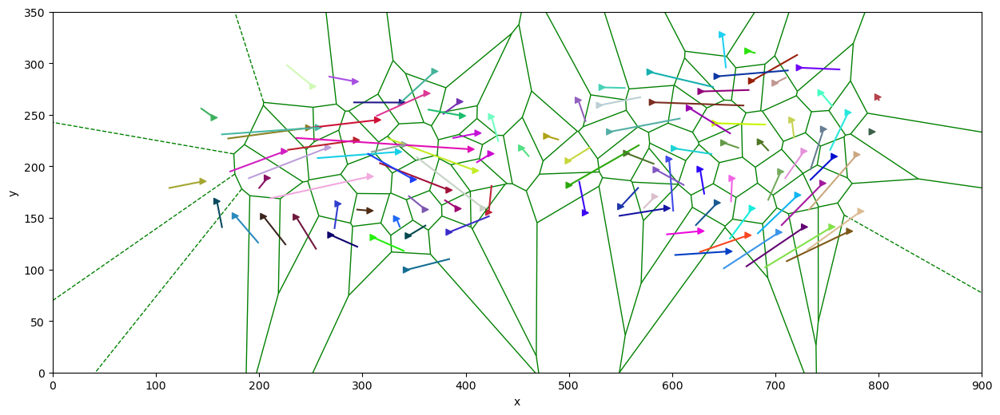

In [157]:
from scipy.spatial import Voronoi, voronoi_plot_2d

# for t in range(image.shape[0]):

t=20
path_img = os.path.join(path, str(t)+'/')

cell_df = pd.read_csv(os.path.join(path_img, "cell_df.csv"), index_col="Unnamed: 0")
cell_plane_df = pd.read_csv(os.path.join(path_img, "cell_plane_df.csv"), index_col="Unnamed: 0")
edge_df = pd.read_csv(os.path.join(path_img, "edge_df.csv"), index_col="Unnamed: 0")
edge_pixel_df = pd.read_csv(os.path.join(path_img, "edge_pixel_df.csv"), index_col="Unnamed: 0")
ZMflow.cell_movement_inside_chevron(cell_plane_df, cell_df, edge_pixel_df, limit=0)



#
fig, ax = plt.subplots()

points = np.array(cell_df[['y_start', 'x_start']])
vor_start = Voronoi(points)
fig = voronoi_plot_2d(vor_start, ax=ax, line_colors="green", show_vertices=False, show_points=False)
# ax.scatter(cell_df['y_start'], cell_df['x_start'], color='green', s=60)
ax.scatter(cell_df[cell_df['y_center']>limit]['y_start'], 
           cell_df[cell_df['y_center']>limit]['x_start'],
           color = np.array(color_list)[cell_df[cell_df['y_center']>limit]['id_im']],
           s=30,
           marker='>',
          )

# points = np.array(cell_df[['y_end', 'x_end']])
# vor_end = Voronoi(points)
# fig = voronoi_plot_2d(vor_end, ax=ax, line_colors="red", show_vertices=False, show_points=False)
# # ax.scatter(cell_df['y_end'], cell_df['x_end'], color='black', s=60)
# ax.scatter(cell_df[cell_df['y_center']>limit]['y_end'],
#            cell_df[cell_df['y_center']>limit]['x_end'],
#            color = np.array(color_list)[cell_df[cell_df['y_center']>limit]['id_im']],
#            s=30, 
#            marker = '*')

for i, val in cell_df[cell_df['y_center']>limit].iterrows():
    ax.plot([val["y_end"], val['y_start']],
            [val["x_end"], val['x_start']],
           color = np.array(color_list)[int(val['id_im'])],)

ax.set_aspect('equal', 'box')
ax.set_xlim(0,900)
ax.set_ylim(0,350)
ax.set_ylabel('y')
ax.set_xlabel('x')
fig.set_size_inches(15,10)


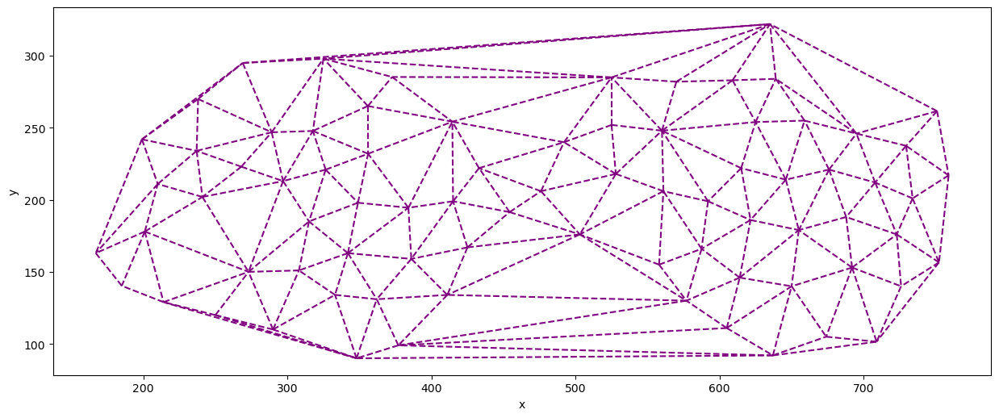

In [184]:
from scipy.spatial import Voronoi, voronoi_plot_2d

# for t in range(image.shape[0]):

t=15
path_img = os.path.join(path, str(t)+'/')

cell_df = pd.read_csv(os.path.join(path_img, "cell_df.csv"), index_col="Unnamed: 0")
cell_plane_df = pd.read_csv(os.path.join(path_img, "cell_plane_df.csv"), index_col="Unnamed: 0")
edge_df = pd.read_csv(os.path.join(path_img, "edge_df.csv"), index_col="Unnamed: 0")
edge_pixel_df = pd.read_csv(os.path.join(path_img, "edge_pixel_df.csv"), index_col="Unnamed: 0")
ZMflow.cell_movement_inside_chevron(cell_plane_df, cell_df, edge_pixel_df, limit=0)


#
fig, ax = plt.subplots()

# points = np.array(cell_df[['y_start', 'x_start']])
# vor_start = Voronoi(points)
# for i,j in vor_start.ridge_points:
#     ax.plot(points[[i,j]].flatten()[[0,2]], points[[i,j]].flatten()[[1,3]], '--', c="green")
# # ax.scatter(cell_df['y_start'], cell_df['x_start'], color='green', s=60)

# points = np.array(cell_df[['y_end', 'x_end']])
# vor_end = Voronoi(points)
# for i,j in vor_end.ridge_points:
#     ax.plot(points[[i,j]].flatten()[[0,2]], points[[i,j]].flatten()[[1,3]], '--', c="red")
# # ax.scatter(cell_df['y_end'], cell_df['x_end'], color='red', s=60)



z_center = 147
cell_df = cell_plane_df[cell_plane_df["z_center"]==z_center]
points = np.array(cell_df[['y_center', 'x_center']])
vor_mid = Voronoi(points)
for i,j in vor_mid.ridge_points:
    ax.plot(points[[i,j]].flatten()[[0,2]], points[[i,j]].flatten()[[1,3]], '--', c="purple")
# ax.scatter(cell_df['y_end'], cell_df['x_end'], color='red', s=60)


ax.set_aspect('equal', 'box')
# ax.set_xlim(0,900)
# ax.set_ylim(0,350)
ax.set_ylabel('y')
ax.set_xlabel('x')
fig.set_size_inches(15,10)


(0.0, 400.0)

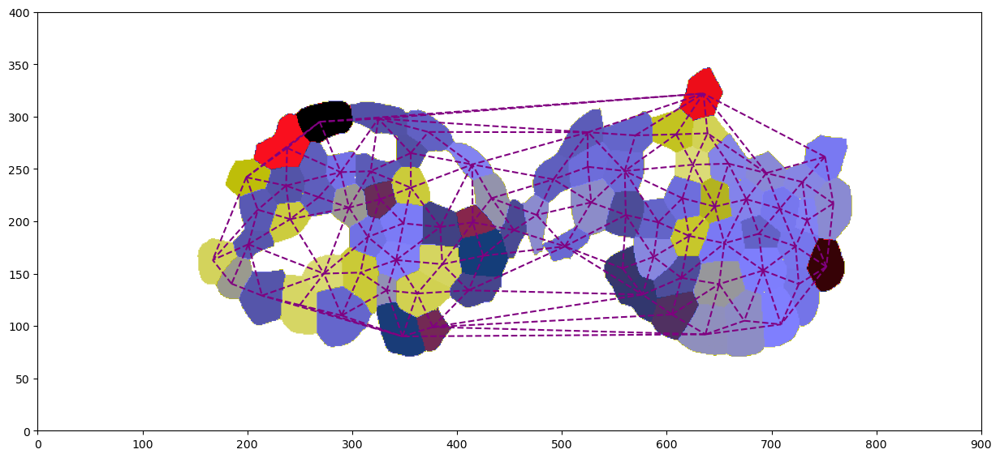

In [185]:
fig, ax = plt.subplots()
ax.imshow(image[t,z_center].T, origin="lower", cmap="gist_stern_r")

# fig = voronoi_plot_2d(vor_start, ax=ax, line_colors="green", show_vertices=False, show_points=False)
# ax.scatter(cell_df['y_start'], cell_df['x_start'], color='green', s=60)

# fig = voronoi_plot_2d(vor_end, ax=ax, line_colors="red", show_vertices=False, show_points=False)
# ax.scatter(cell_df['y_end'], cell_df['x_end'], color='red', s=60)

# fig = voronoi_plot_2d(vor_mid, ax=ax, line_colors="purple", show_vertices=False, show_points=True)
for i,j in vor_mid.ridge_points:
    ax.plot(points[[i,j]].flatten()[[0,2]], points[[i,j]].flatten()[[1,3]], '--', c="purple")

ax.set_aspect('equal', 'box')
fig.set_size_inches(15,10)
ax.set_xlim(0,900)
ax.set_ylim(0,400)

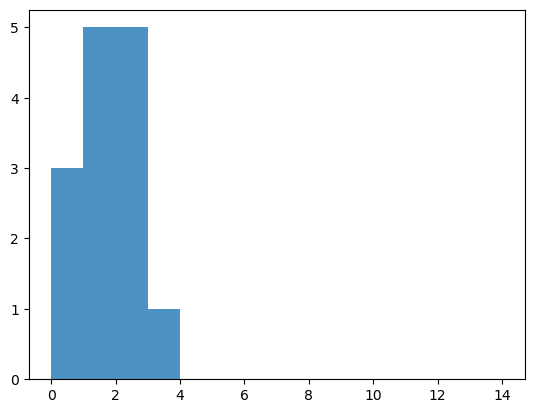

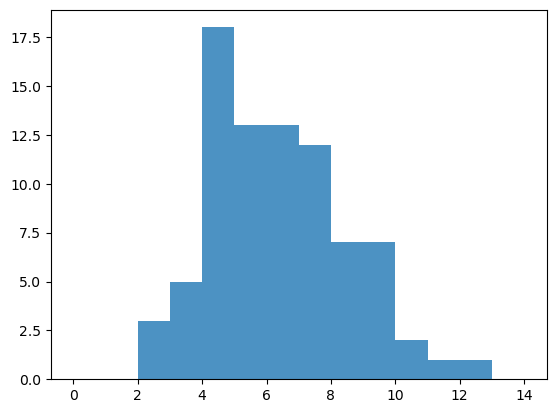

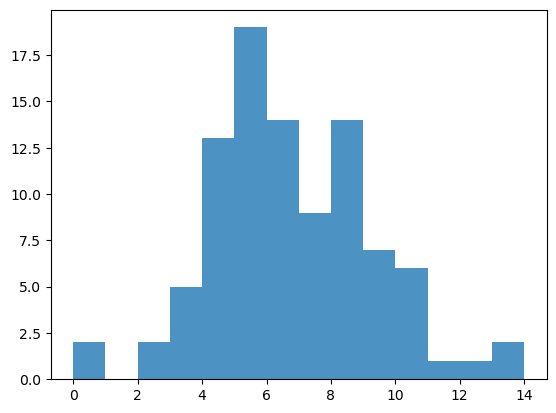

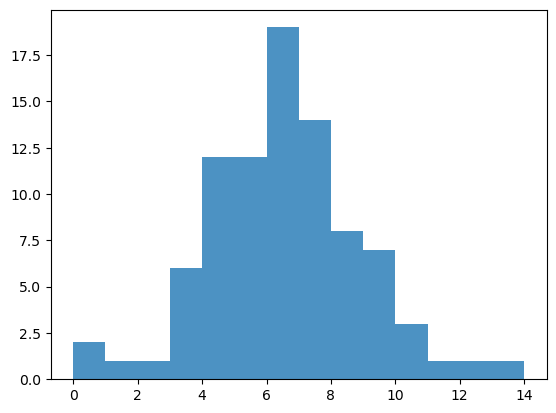

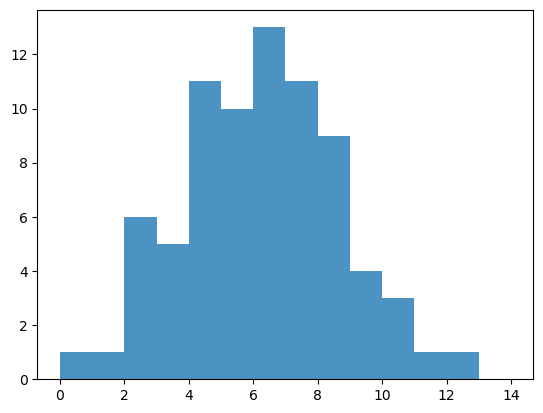

In [216]:
for t in range(10, image.shape[0],5):
    path_img = os.path.join(path, str(t)+'/')
    cell_df = pd.read_csv(os.path.join(path_img, "cell_df.csv"), index_col="Unnamed: 0")
    fig, ax = plt.subplots()
    hist = ax.hist(cell_df['nb_neighbor'], alpha=0.8, bins=14, range=(0,14))
#     hist = ax.hist(cell_df['volume'], alpha=0.8,range=(0,6000))

,id_im,x_center,y_center,z_center,nb_neighbor,volume,real_dist,short_dist,curv_ind,x_start,y_start,z_start,x_end,y_end,z_end,orient_zy,orient_xy,orient_xz
0,32,230.584369,672.088337,169.871520,5,1691.830791,55.803545,52.072439,0.066861,233.525469,646.394102,116.0,222.5,687.0,219.0,68.484053,-15.190921,-6.109869
1,33,157.490237,254.975483,145.363110,4,3171.508767,62.030744,58.963150,0.049453,167.254348,279.408696,86.0,148.0,244.0,203.0,106.837832,-151.463777,-9.345236
2,36,130.510104,219.581338,153.806769,4,2630.159082,49.970105,46.137930,0.076689,148.313776,218.071429,108.0,131.0,227.0,200.0,84.456822,-62.720215,-10.658020
3,37,154.422766,386.049648,115.039950,7,3133.230840,73.683052,67.219124,0.087726,125.297273,382.339091,45.0,176.0,365.0,178.0,97.427708,108.879432,20.868023
4,41,128.395863,350.881125,116.116747,8,4470.145209,78.243202,62.232489,0.204628,110.994398,351.596639,54.0,140.0,347.0,178.0,92.122963,99.005015,13.165687
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71,207,166.134088,97.948768,92.774364,0,2485.084734,68.545366,65.372800,0.046284,182.391389,128.925636,23.0,148.0,82.0,152.0,109.989597,-143.762636,-14.927847
72,216,305.030667,679.172477,160.054780,2,1603.620765,62.303561,54.586747,0.123858,282.473214,680.928571,102.0,299.0,684.0,211.0,88.385933,79.471949,8.621626
73,218,306.824341,742.944495,179.123013,2,1883.337638,59.437598,52.227389,0.121307,279.565632,751.033413,126.0,300.0,734.0,230.0,99.301481,129.813469,11.116115
74,220,185.217792,233.793182,187.827674,10,4978.541718,64.167114,57.437044,0.104883,196.414110,273.372699,136.0,173.0,186.0,246.0,128.460020,-164.998369,-12.016389
